#### Import packages

In [1]:
from PIL import Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2 # installed from opencv-python
import os

#### Define functions

In [2]:
def fetch_data_diode(type):
    """Returns a shuffled DIODE dataframe of either 'train' or 'val' data."""
    df = pd.read_csv(type + '_outdoor.csv', header=None)
    df = df.drop(df.columns[[3]], axis=1)
    df.columns = ['image', 'depth', 'mask']
    df = df.sample(frac=1)
    df = df.reset_index()

    return df

def fetch_data_kitti():
    """Returns a shuffled KITTI selection dataframe."""
    df = pd.read_csv('kitti_selection.csv', header=None)
    df.columns = ['image', 'depth']
    df = df.sample(frac=1)
    df = df.reset_index()

    return df

def fetch_data_ihu():
    """Returns a shuffled IHU dataframe."""
    df = pd.read_csv('ihu.csv', header=None)
    df.columns = ['image']
    df = df.sample(frac=1)
    df = df.reset_index()

    return df

def load_img(img_path):
    """Resizes an image."""
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    width = img.shape[1]
    if width == 1024:
        img = cv2.resize(img, (256,192))
    else:
        img = cv2.resize(img, (304,88))

    return img

def resize_npy(depth_path):
    """Resizes a numpy array to KITTI selection dimensions."""
    depth = np.load(depth_path)
    depth = Image.fromarray(depth)
    depth = depth.resize((1216,352))
    depth = np.asarray(depth).squeeze()

    return depth

def load_npy(depth_path, mask_path):
    """Returns the depth map of a numpy array and its mask."""
    depth = np.load(depth_path).squeeze()
    mask = np.load(mask_path)
    mask = cv2.resize(mask, (256,192))
    depth = cv2.resize(depth, (256,192))
    mask = mask > 0

    min_depth = 0
    max_depth = min(300, np.percentile(depth, 99))
    depth = np.clip(depth, min_depth, max_depth)
    depth = depth/300

    depth = np.ma.masked_where(~mask, depth)

    return depth

def show_samples_diode(sample1, sample2):
    """Displays DIODE training and validation samples."""
    cmap = plt.cm.jet
    cmap.set_bad(color='black')

    fig, ax = plt.subplots(5, 4, figsize=(40, 40))
    for i in range(5):
        ax[i, 0].imshow(load_img(sample1["image"][i]))
        ax[i, 1].imshow(load_npy(sample1["depth"][i],sample1["mask"][i]), cmap=cmap)
        ax[i, 2].imshow(load_img(sample2["image"][i]))
        ax[i, 3].imshow(load_npy(sample2["depth"][i],sample2["mask"][i]), cmap=cmap)
        for j in range (4):
            ax[i, j].axis('off')

    plt.tight_layout()
    plt.show()

def show_samples_kitti(sample):
    """Displays KITTI selection test samples."""
    cmap = plt.cm.jet
    cmap.set_bad(color='black')

    fig, ax = plt.subplots(5, 2, figsize=(45, 35))
    for i in range(5):
        ax[i, 0].imshow(load_img(sample["image"][i]))
        ax[i, 1].imshow(np.load(sample["depth"][i]).squeeze(), cmap=cmap)
        for j in range (2):
            ax[i, j].axis('off')

    plt.tight_layout()
    plt.show()

def show_samples_ihu(sample):
    """Displays IHU test samples."""
    idx = 0
    fig, ax = plt.subplots(5, 4, figsize=(40, 40))
    for i in range(5):
        for j in range(4):
            ax[i, j].imshow(load_img(sample["image"][idx]))
            ax[i, j].axis('off')
            idx+=1

    plt.tight_layout()
    plt.show()

def show_pred_diode(sample):
    """Displays DIODE predictions."""
    cmap = plt.cm.jet
    cmap.set_bad(color='black')

    fig, ax = plt.subplots(5, 3, figsize=(40, 50))
    for i in range(5):
        ax[i, 0].imshow(load_img(sample["image"][i]))
        ax[i, 1].imshow(load_npy(sample["depth_truth"][i],sample["mask"][i]), cmap=cmap)
        ax[i, 2].imshow(load_npy(sample["depth_pred"][i],sample["mask"][i]), cmap=cmap)
        for j in range (3):
            ax[i, j].axis('off')

    plt.tight_layout()
    plt.show()

def show_pred_kitti(sample):
    """Displays KITTI selection predictions."""
    cmap = plt.cm.jet
    cmap.set_bad(color='black')

    fig, ax = plt.subplots(5, 3, figsize=(60, 30))
    for i in range(5):
        ax[i, 0].imshow(load_img(sample["image"][i]))
        ax[i, 1].imshow(np.load(sample["depth_truth"][i]).squeeze(), cmap=cmap)
        ax[i, 2].imshow(resize_npy(sample["depth_pred"][i]), cmap=cmap)
        for j in range (3):
            ax[i, j].axis('off')

    plt.tight_layout()
    plt.show()

def show_pred_ihu(sample):
    """Displays IHU predictions."""
    cmap = plt.cm.jet
    cmap.set_bad(color='black')

    idx = 0
    fig, ax = plt.subplots(5, 4, figsize=(40, 40))
    for i in range(5):
        ax[i, 0].imshow(load_img(sample["image"][idx]))
        ax[i, 1].imshow(np.load(sample["depth_pred"][idx]).squeeze(), cmap=cmap)
        idx+=1
        ax[i, 2].imshow(load_img(sample["image"][idx]))
        ax[i, 3].imshow(np.load(sample["depth_pred"][idx]).squeeze(), cmap=cmap)
        idx+=1
        for j in range (4):
            ax[i, j].axis('off')

    plt.tight_layout()
    plt.show()

 #### Display DIODE samples

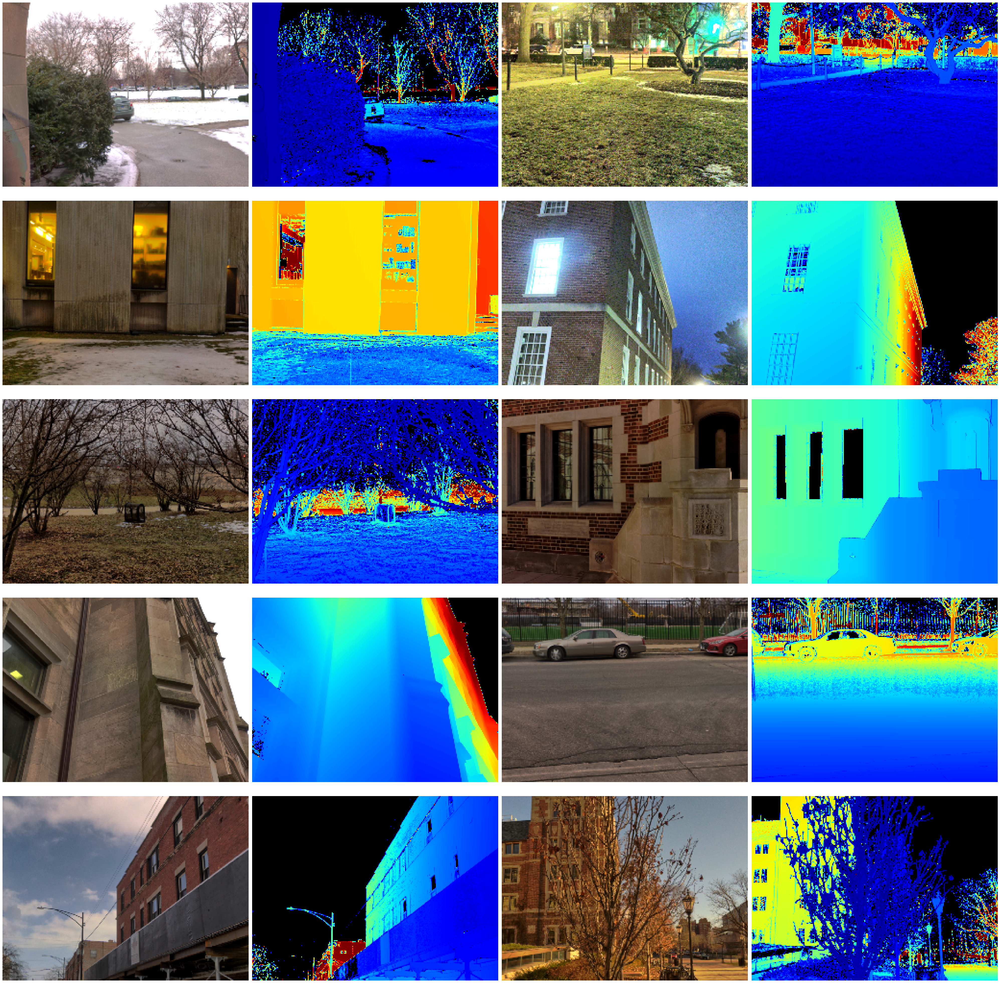

In [3]:
# set path to DIODE folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\DIODE')

# get data
train = fetch_data_diode('train')
val = fetch_data_diode('val')

# show samples
show_samples_diode(train, val)

#### Display DIODE predictions

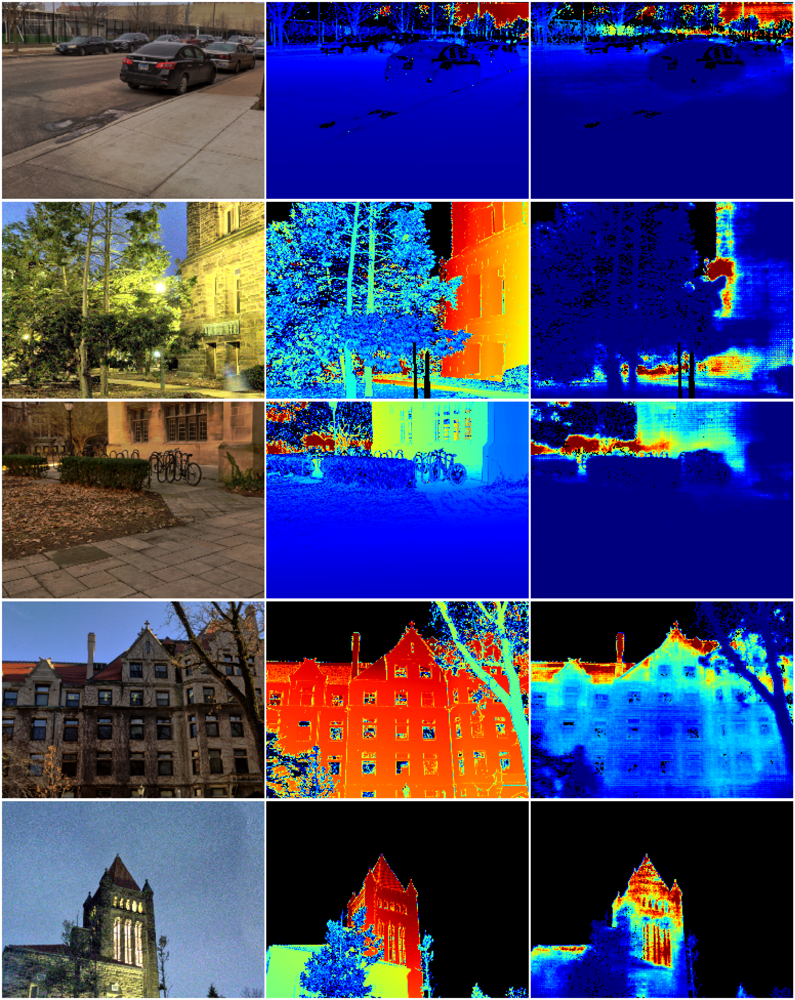

In [4]:
# set path to DIODE folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\DIODE')

# get data
val = pd.read_csv('val_outdoor.csv', header=None)
val = val.drop(val.columns[[3]], axis=1)
val.columns = ['image', 'depth', 'mask']

# get predictions
pred = os.listdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\models\\PixelFormer\\prediction\\DIODE')
test = pd.DataFrame(index=range(len(pred)),columns=range(4))
test.columns = ['image', 'depth_truth', 'depth_pred', 'mask']

# fill the test dataset
for i in range(len(pred)):
    test['image'][i] = val['image'][i]
    test['depth_truth'][i] = val['depth'][i]
    test['depth_pred'][i] = '../../models/PixelFormer/prediction/DIODE/'+pred[i]
    test['mask'][i] = val['mask'][i]

# shuffle the test dataset
test = test.sample(frac=1)
test = test.reset_index()

# show predictions
show_pred_diode(test)

#### Display KITTI selection samples

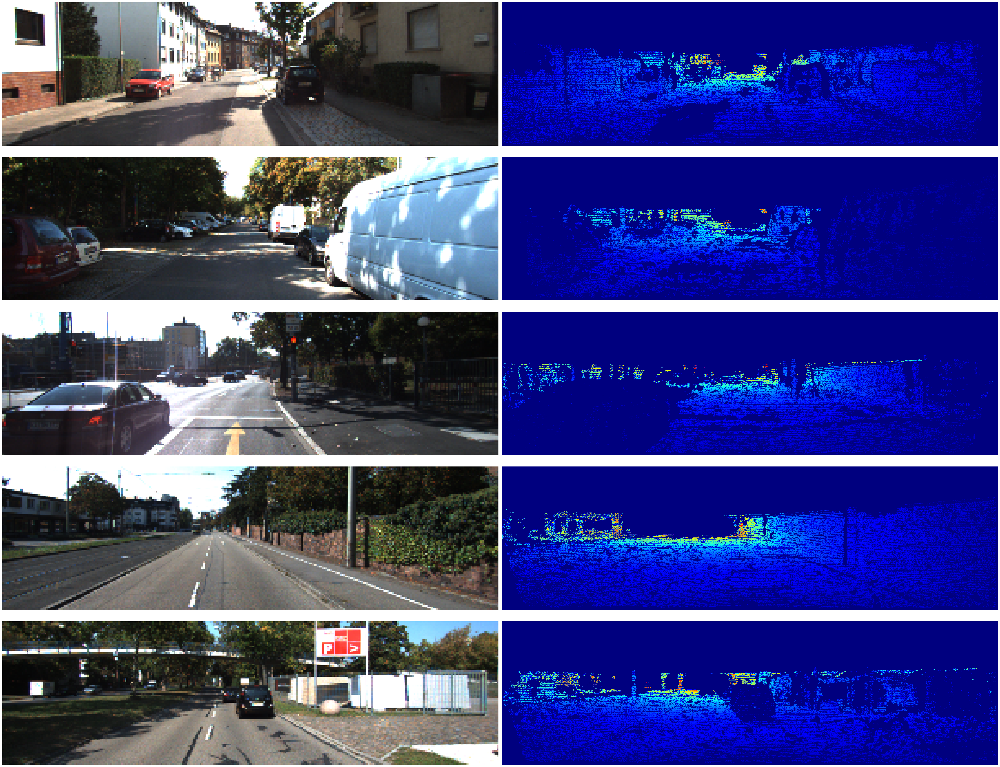

In [5]:
# set path to KITTI folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\KITTI')

# get data
kitti = fetch_data_kitti()

# show samples
show_samples_kitti(kitti)

#### Display KITTI selection predictions

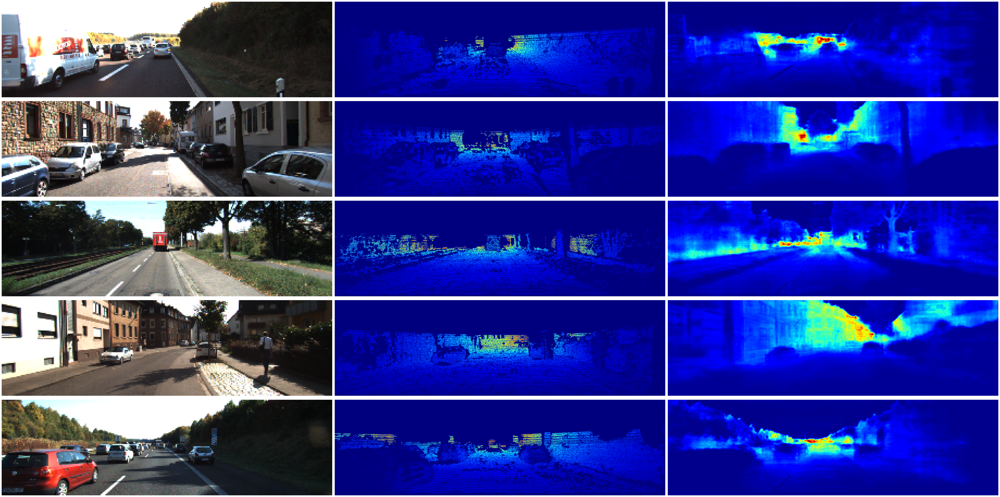

In [6]:
# set path to KITTI folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\KITTI')

# get data
kitti = pd.read_csv('kitti_selection.csv', header=None)
kitti.columns = ['image', 'depth']

# get predictions
pred = os.listdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\models\\PixelFormer\\prediction\\KITTI')
test = pd.DataFrame(index=range(len(pred)),columns=range(3))
test.columns = ['image', 'depth_truth', 'depth_pred']

# fill the test dataset
for i in range(len(pred)):
    test['image'][i] = kitti['image'][i]
    test['depth_truth'][i] = kitti['depth'][i]
    test['depth_pred'][i] = '../../models/PixelFormer/prediction/KITTI/'+pred[i]

# shuffle the test dataset
test = test.sample(frac=1)
test = test.reset_index()

# show predictions
show_pred_kitti(test)

 #### Display IHU samples

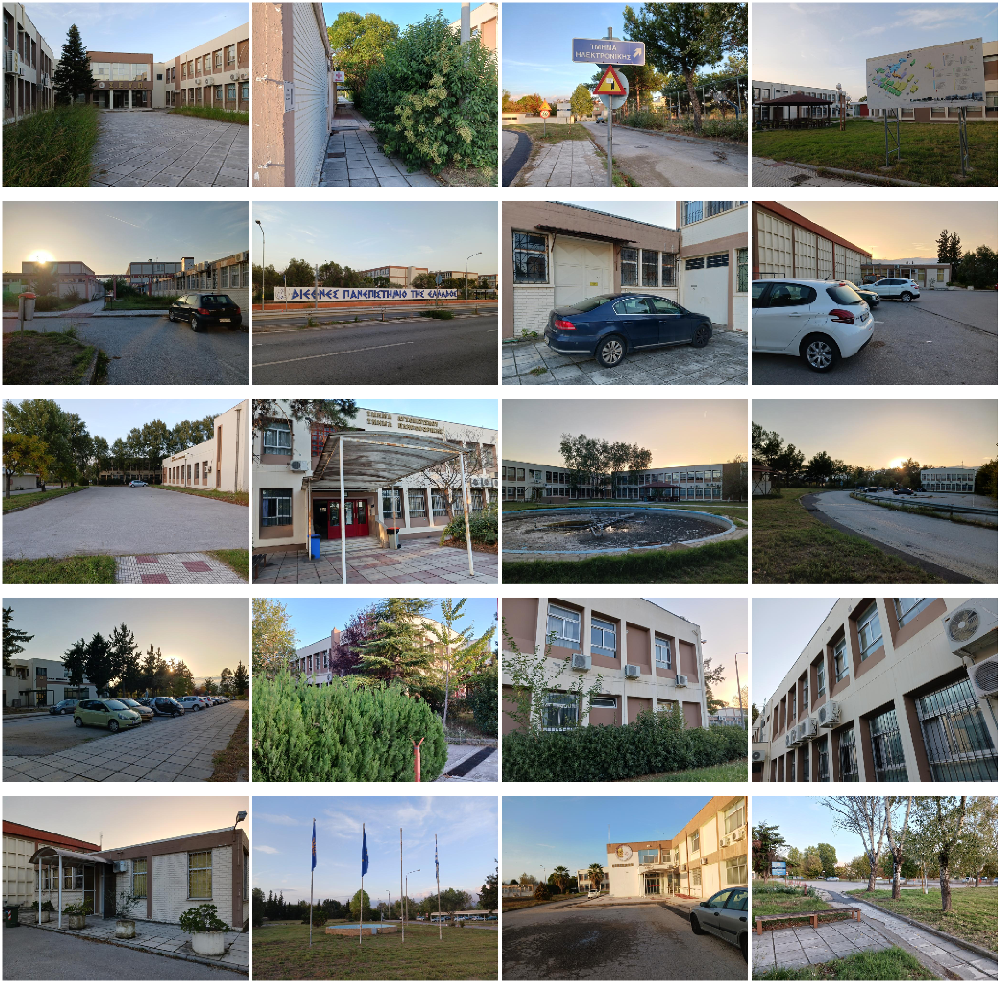

In [7]:
# set path to IHU folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\IHU')
ihu = fetch_data_ihu()

# show samples
show_samples_ihu(ihu)

#### Display IHU predictions

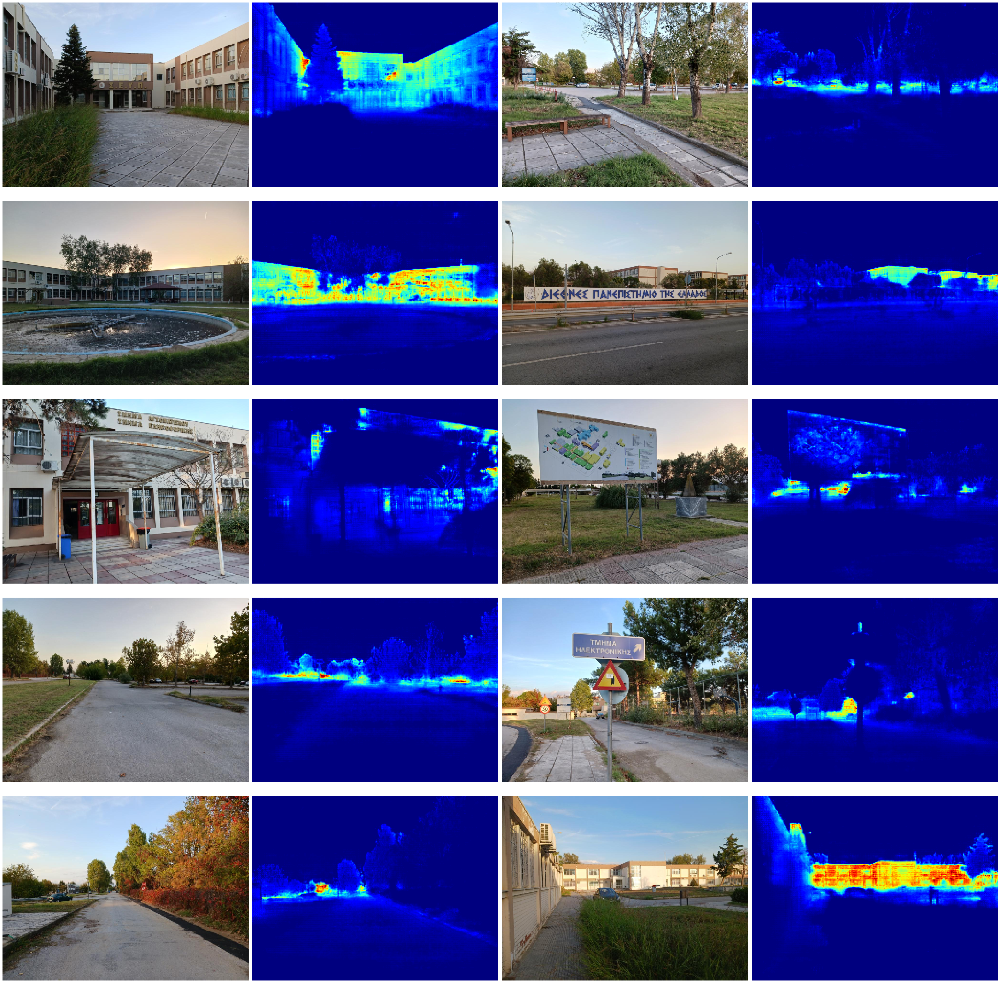

In [8]:
# set path to IHU folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\dataset\\IHU')

# get data
ihu = pd.read_csv('ihu.csv', header=None)
ihu.columns = ['image']

# get predictions
pred = os.listdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\models\\PixelFormer\\prediction\\IHU')
test = pd.DataFrame(index=range(len(pred)),columns=range(2))
test.columns = ['image', 'depth_pred']

# fill the test dataset
for i in range(len(pred)):
    test['image'][i] = ihu['image'][i]
    test['depth_pred'][i] = '../../models/PixelFormer/prediction/IHU/'+pred[i]

# shuffle the test dataset
test = test.sample(frac=1)
test = test.reset_index()

# show samples
show_pred_ihu(test)

#### Display SILog loss and RMSE metrics

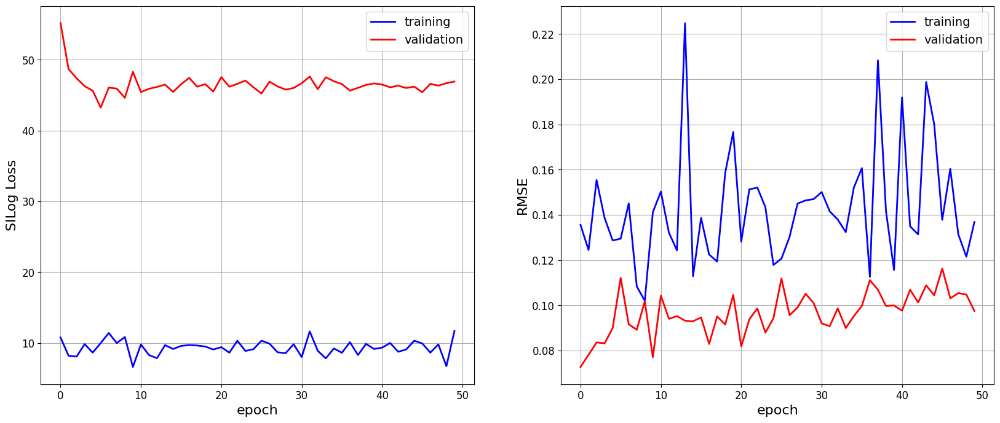

In [3]:
# set path to metrics folder
os.chdir('D:\\Informatics\\Μεταπτυχιακό\\Εξάμηνο Γ\\models\\PixelFormer\\metrics')

# get metrics
metrics = pd.read_csv('tmetrics.csv')

# prepare the figure
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))

# plot train-val SILog loss
ax1.plot(metrics['train_loss'], 'b', linewidth=2)
ax1.plot(metrics['val_loss'], 'r', linewidth=2)
ax1.legend(['training', 'validation'], fontsize=14)
ax1.set_xlabel('epoch', fontsize=16)
ax1.set_ylabel('SILog Loss', fontsize=16)
ax1.tick_params(axis='both', which='major', labelsize=12)
ax1.grid()

# plot train-val RMSE
ax2.plot(metrics['train_rmse'], 'b', linewidth=2)
ax2.plot(metrics['val_rmse'], 'r', linewidth=2)
ax2.legend(['training', 'validation'], fontsize=14)
ax2.set_xlabel('epoch', fontsize=16)
ax2.set_ylabel('RMSE', fontsize=16)
ax2.tick_params(axis='both', which='major', labelsize=12)
ax2.grid()